In [37]:
# backend/segmentation.py
import numpy as np
import torch
import cv2
from PIL import Image
from transformers import SegformerFeatureExtractor, SegformerForSemanticSegmentation

# Load feature extractor and model from Hugging Face.
feature_extractor = SegformerFeatureExtractor.from_pretrained("nvidia/segformer-b1-finetuned-ade-512-512")
model = SegformerForSemanticSegmentation.from_pretrained("nvidia/segformer-b1-finetuned-ade-512-512")
model.eval()  # Set the model to evaluation mode.

# Optional: Define a colormap for the segmentation classes.
# (Here we use a simple random colormap for demonstration.)
def random_colormap(num_classes):
    return np.random.randint(0, 255, size=(num_classes, 3), dtype=np.uint8)

# The ADE20K dataset (used for training this model) has 150 classes.
COLORMAP = random_colormap(150)


def segment(image_array):
    
    # Convert the NumPy array to a PIL Image.
    image_pil = np.array(image_array)
    
    # Preprocess the image.
    inputs = feature_extractor(image_pil, return_tensors="pt")
    
    # Run the model.
    with torch.no_grad():
        outputs = model(**inputs)
    
    # Get the logits and compute the segmentation map.
    logits = outputs.logits  # Shape: (batch_size, num_classes, height, width)
    segmentation_map = logits.argmax(dim=1)[0].cpu().numpy()  # Shape: (height, width)
    
    # Create a color segmentation image using the colormap.
    segmentation_color = COLORMAP[segmentation_map]
    
    # Blend the segmentation with the original image.
    result_image = cv2.addWeighted(image_array, 0.5, segmentation_color, 0.5, 0)
    
    return result_image


/Users/saadasif/MyShelf/CODE_REPO/image-segmentation-streamlit/venv/lib/python3.12/site-packages/transformers/models/segformer/feature_extraction_segformer.py:28: FutureWarning: The class SegformerFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use SegformerImageProcessor instead.
  warnings.warn(
/Users/saadasif/MyShelf/CODE_REPO/image-segmentation-streamlit/venv/lib/python3.12/site-packages/transformers/utils/deprecation.py:165: UserWarning: The following named arguments are not valid for `SegformerFeatureExtractor.__init__` and were ignored: 'feature_extractor_type'
  return func(*args, **kwargs)


In [7]:
from PIL import Image

img = Image.open('/Users/saadasif/MyShelf/CODE_REPO/image-segmentation-streamlit/pexels-nout-gons-80280-378570.jpg')

img_arr = np.array(img)

img_arr

array([[[ 26,  26,  26],
        [ 24,  24,  24],
        [ 23,  23,  23],
        ...,
        [ 21,  26,  22],
        [ 26,  28,  27],
        [ 27,  28,  30]],

       [[ 28,  28,  28],
        [ 26,  26,  26],
        [ 24,  24,  24],
        ...,
        [ 24,  29,  23],
        [ 35,  37,  36],
        [ 43,  45,  44]],

       [[ 29,  29,  29],
        [ 27,  27,  27],
        [ 25,  25,  25],
        ...,
        [ 16,  21,  15],
        [ 24,  26,  23],
        [ 33,  35,  32]],

       ...,

       [[ 56,  70,  79],
        [ 59,  73,  82],
        [ 61,  75,  84],
        ...,
        [122, 140, 140],
        [122, 142, 141],
        [118, 138, 137]],

       [[ 55,  69,  78],
        [ 57,  71,  80],
        [ 59,  73,  82],
        ...,
        [124, 142, 142],
        [124, 144, 143],
        [120, 140, 139]],

       [[ 55,  69,  78],
        [ 57,  71,  80],
        [ 57,  71,  80],
        ...,
        [121, 139, 139],
        [120, 140, 139],
        [116, 136, 135]]

In [8]:
import numpy as np
import torch
import cv2
from PIL import Image
from transformers import SegformerFeatureExtractor, SegformerForSemanticSegmentation

# Load feature extractor and model from Hugging Face.
feature_extractor = SegformerFeatureExtractor.from_pretrained("nvidia/segformer-b1-finetuned-ade-512-512")
model = SegformerForSemanticSegmentation.from_pretrained("nvidia/segformer-b1-finetuned-ade-512-512")
model.eval()  # Set the model to evaluation mode.




/Users/saadasif/MyShelf/CODE_REPO/image-segmentation-streamlit/venv/lib/python3.12/site-packages/transformers/models/segformer/feature_extraction_segformer.py:28: FutureWarning: The class SegformerFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use SegformerImageProcessor instead.
  warnings.warn(
/Users/saadasif/MyShelf/CODE_REPO/image-segmentation-streamlit/venv/lib/python3.12/site-packages/transformers/utils/deprecation.py:165: UserWarning: The following named arguments are not valid for `SegformerFeatureExtractor.__init__` and were ignored: 'feature_extractor_type'
  return func(*args, **kwargs)


SegformerForSemanticSegmentation(
  (segformer): SegformerModel(
    (encoder): SegformerEncoder(
      (patch_embeddings): ModuleList(
        (0): SegformerOverlapPatchEmbeddings(
          (proj): Conv2d(3, 64, kernel_size=(7, 7), stride=(4, 4), padding=(3, 3))
          (layer_norm): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        )
        (1): SegformerOverlapPatchEmbeddings(
          (proj): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
          (layer_norm): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
        )
        (2): SegformerOverlapPatchEmbeddings(
          (proj): Conv2d(128, 320, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
          (layer_norm): LayerNorm((320,), eps=1e-05, elementwise_affine=True)
        )
        (3): SegformerOverlapPatchEmbeddings(
          (proj): Conv2d(320, 512, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
          (layer_norm): LayerNorm((512,), eps=1e-05, elementwise_affine=True)

In [9]:

stg1

{'pixel_values': tensor([[[[-1.7069, -1.7412, -1.7925,  ..., -1.4672, -1.2274, -1.5870],
          [-1.6727, -1.6898, -1.7412,  ..., -1.3130, -1.2788, -1.4158],
          [-1.6213, -1.6555, -1.7240,  ..., -1.4158, -1.3130, -1.0390],
          ...,
          [-1.0219, -1.0219, -1.0219,  ..., -0.4397, -0.5082, -0.6623],
          [-1.0219, -1.0562, -1.1247,  ..., -0.2171, -0.2684, -0.2684],
          [-1.1247, -1.2103, -1.3302,  ...,  0.1083, -0.1486, -0.1999]],

         [[-1.6155, -1.6506, -1.7031,  ..., -1.2654, -1.0203, -1.3354],
          [-1.5805, -1.5980, -1.6506,  ..., -1.0728, -1.0378, -1.1779],
          [-1.5280, -1.5630, -1.6331,  ..., -1.1078, -1.0728, -0.8452],
          ...,
          [-0.7052, -0.7052, -0.7052,  ..., -0.3025, -0.3725, -0.5476],
          [-0.7052, -0.7052, -0.7402,  ...,  0.0476,  0.0476, -0.0399],
          [-0.7752, -0.8627, -0.9153,  ...,  0.4328,  0.2227,  0.1877]],

         [[-1.3861, -1.4210, -1.4733,  ..., -1.1944, -1.0027, -1.3513],
          [-1

In [ ]:
model = torch.from_file
feature_extractor = 

(3253, 5088, 3)
torch.Size([1, 3, 512, 512])
torch.Size([1, 150, 128, 128])
(128, 128, 3)


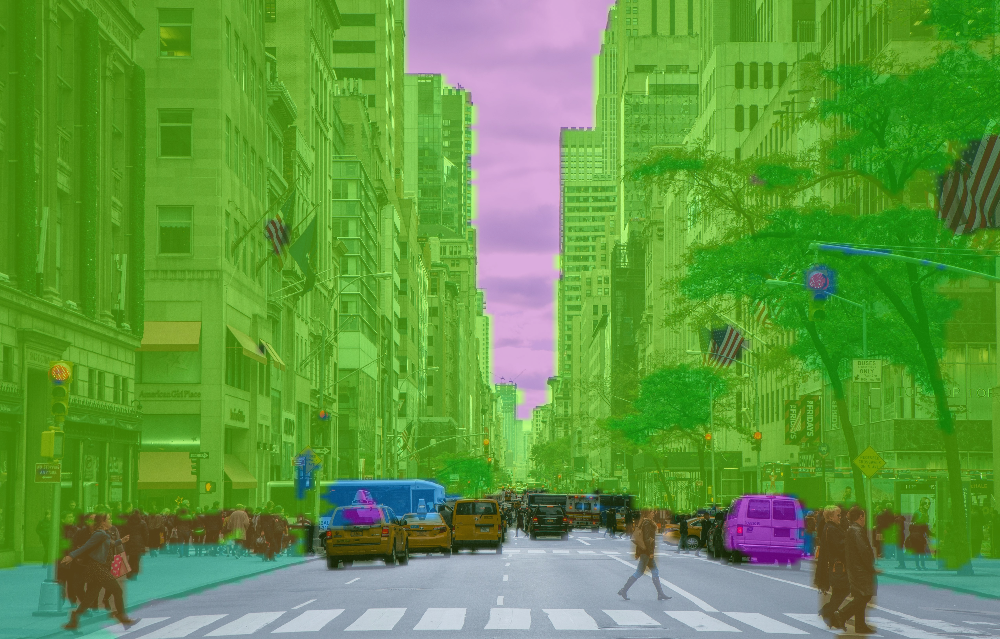

In [57]:
print(img_arr.shape)
stg1 = feature_extractor(np.array(img_arr), return_tensors = 'pt')

print(stg1['pixel_values'].shape)

with torch.no_grad():
    outputs = model(**stg1)

print(outputs.logits.shape)

logits = outputs.logits
segmentation_map = logits.argmax(dim = 1)[0].cpu().numpy()
segmentation_color = COLORMAP[segmentation_map]

print(segmentation_color.shape)

segmentation_color = cv2.resize(segmentation_color, (img_arr.shape[1], img_arr.shape[0]))

result_image = cv2.addWeighted(img_arr, 0.5, segmentation_color, 0.5, 0)

Image.fromarray(result_image)

In [2]:
import cv2

# Load two images
image1 = cv2.imread("temp1.jpeg")
image2 = cv2.imread("temp2.jpeg")

# Ensure both images are the same size
image2 = cv2.resize(image2, (image1.shape[1], image1.shape[0]))

# Blend the images
blended = cv2.addWeighted(image1, 0.7, image2, 0.3, 0)

# Display the result
# cv2.imshow("Blended Image", blended)
# cv2.waitKey(0)
# cv2.destroyAllWindows()

In [4]:
type(image1)

numpy.ndarray

## Moving the model, to local

In [60]:
path = "./models/nvidia/segformer-b1-finetuned-ade-512-512/"

## save entire model
torch.save(model, path + 'model.pth')

## save model state
torch.save(model.state_dict(), path + "model_weights.pth")

## saving the feature extractor
feature_extractor.to_json_file(path + 'feature_extractor')



In [58]:
model

SegformerForSemanticSegmentation(
  (segformer): SegformerModel(
    (encoder): SegformerEncoder(
      (patch_embeddings): ModuleList(
        (0): SegformerOverlapPatchEmbeddings(
          (proj): Conv2d(3, 64, kernel_size=(7, 7), stride=(4, 4), padding=(3, 3))
          (layer_norm): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        )
        (1): SegformerOverlapPatchEmbeddings(
          (proj): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
          (layer_norm): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
        )
        (2): SegformerOverlapPatchEmbeddings(
          (proj): Conv2d(128, 320, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
          (layer_norm): LayerNorm((320,), eps=1e-05, elementwise_affine=True)
        )
        (3): SegformerOverlapPatchEmbeddings(
          (proj): Conv2d(320, 512, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
          (layer_norm): LayerNorm((512,), eps=1e-05, elementwise_affine=True)

In [62]:
model.save_pretrained(path + 'model')

'./models/nvidia/segformer-b1-finetuned-ade-512-512/'

In [64]:
feature_extractor.save_pretrained(path + 'feature_extractor')

['./models/nvidia/segformer-b1-finetuned-ade-512-512/feature_extractor/preprocessor_config.json']

In [71]:
import numpy as np
import torch
import cv2
from PIL import Image
from transformers import SegformerFeatureExtractor, SegformerForSemanticSegmentation


path = "./models/nvidia/segformer-b1-finetuned-ade-512-512/"

model = SegformerForSemanticSegmentation.from_pretrained(path + 'model')
feature_extractor = SegformerFeatureExtractor.from_pretrained(path + 'feature_extractor')
model.eval()


def random_color(num_classes):
    return np.random.randint(0, 255, size = (num_classes, 3), dtype = np.uint8)


COLORMAP = random_colormap(150)




In [ ]:
def segment(image_array):

    img_arr = np.array(image_array)

    stg1 = feature_extractor(img_arr, return_tensors = 'pt')

    with torch.no_grad():
        outputs = model(**stg1)

    logits = outputs.logits
    segmentation_map = logits.argmax(dim = 1)[0].cpu().numpy()
    segmentation_color = COLORMAP[segmentation_color]

    segmentation_color = cv2.resize(segmentation_color, (img_arr.shape[1], img_arr.shape[0]))
    result_image = cv2.addWeighted(img_arr, 0.5, segmentation_color, 0.5, 0)

    return result_image

In [73]:
np.array(img)

array([[[ 26,  26,  26],
        [ 24,  24,  24],
        [ 23,  23,  23],
        ...,
        [ 21,  26,  22],
        [ 26,  28,  27],
        [ 27,  28,  30]],

       [[ 28,  28,  28],
        [ 26,  26,  26],
        [ 24,  24,  24],
        ...,
        [ 24,  29,  23],
        [ 35,  37,  36],
        [ 43,  45,  44]],

       [[ 29,  29,  29],
        [ 27,  27,  27],
        [ 25,  25,  25],
        ...,
        [ 16,  21,  15],
        [ 24,  26,  23],
        [ 33,  35,  32]],

       ...,

       [[ 56,  70,  79],
        [ 59,  73,  82],
        [ 61,  75,  84],
        ...,
        [122, 140, 140],
        [122, 142, 141],
        [118, 138, 137]],

       [[ 55,  69,  78],
        [ 57,  71,  80],
        [ 59,  73,  82],
        ...,
        [124, 142, 142],
        [124, 144, 143],
        [120, 140, 139]],

       [[ 55,  69,  78],
        [ 57,  71,  80],
        [ 57,  71,  80],
        ...,
        [121, 139, 139],
        [120, 140, 139],
        [116, 136, 135]]